# EDA (시각화)

## U1, U2, U3, U4, U5 위치 확인

In [134]:
m = folium.Map(location = [37.3, 131.3],
               zoom_start = 9.2, 
               width = 750, 
               height = 550)

for i in range(len(UIG_station)):
    marker = folium.CircleMarker([UIG_station.loc[i]['Latitude (°N)'], UIG_station.loc[i]['Longitude (°E)']], 
                                 color = 'red', radius = 25, fill = True, fill_opacity = 0.25,
                                 weight = 3, tooltip = UIG_station.loc[i]['Station name']).add_to(m)
    
m

## U1-U3 유속 추세 비교

In [135]:
u1a = UIG_U1a.set_index('date')['Ur Current speed (cm/s)']
u1b = UIG_U1b.set_index('date')['Ur Current speed (cm/s)']
u2a = UIG_U2a.set_index('date')['Ur Current speed (cm/s)']
u2b = UIG_U2b.set_index('date')['Ur Current speed (cm/s)']
u3a = UIG_U3a.set_index('date')['Ur Current speed (cm/s)']
u3b = UIG_U3b.set_index('date')['Ur Current speed (cm/s)']

In [136]:
station  = ['u1a', 'u1b', 'u2a', 'u2b', 'u3a', 'u3b']

df_ur_all = pd.concat([u1a, u1b, u2a, u2b, u3a, u3b], axis=1)
df_ur_all.columns = station
df_ur_all.columns.name = 'station'
df_ur_all

station,u1a,u1b,u2a,u2b,u3a,u3b
date,,,,,,
2002-11-30 13:00:00,0.000069,0.000136,-0.000004,0.000002,0.389712,0.091350
2002-11-30 14:00:00,0.000218,0.000429,-0.000035,0.000018,0.415690,0.141834
2002-11-30 15:00:00,0.000531,0.001044,-0.000148,0.000070,0.436642,0.207899
2002-11-30 16:00:00,0.001077,0.002119,-0.000406,0.000163,0.452170,0.290583
2002-11-30 17:00:00,0.001919,0.003777,-0.000832,0.000235,0.461982,0.390177
...,...,...,...,...,...,...
2004-04-06 22:00:00,0.106519,-0.225337,-5.852380,-7.767317,-0.536117,NaN
2004-04-06 23:00:00,-0.092469,-0.537205,-5.646616,-7.439072,-0.494862,NaN
2004-04-07 00:00:00,-0.283257,-0.847577,-5.445145,-7.121351,-0.458230,NaN


In [137]:
fig = px.area(df_ur_all, facet_col='station', facet_col_wrap=2)
fig.show()

## 지점 / 년도별 유속 통계 변화량

### U1 수심 1760m 지점

In [138]:
UIG_U1a[UIG_U1a['Year'] == 2002]['Ur Current speed (cm/s)'].describe()
UIG_U1a[UIG_U1a['Year'] == 2003]['Ur Current speed (cm/s)'].describe()
UIG_U1a[UIG_U1a['Year'] == 2004]['Ur Current speed (cm/s)'].describe()

count    755.000000
mean      -0.048342
std        0.257265
min       -1.076359
25%       -0.023565
50%       -0.000004
75%        0.017651
max        0.567511
Name: Ur Current speed (cm/s), dtype: float64

count    8760.000000
mean        0.053198
std         1.572775
min        -5.596846
25%        -0.485441
50%         0.000000
75%         0.759220
max         4.808827
Name: Ur Current speed (cm/s), dtype: float64

count    2331.000000
mean       -0.976185
std         2.670557
min       -11.839499
25%        -2.812544
50%        -0.424477
75%         1.000409
max         5.940721
Name: Ur Current speed (cm/s), dtype: float64

* 2002년 유속 최댓값 : 0.567511     / 유속 최솟값 : -1.076359     / 유속 평균값 : -0.048214
* 2003년 유속 최댓값 : 4.808827     / 유속 최솟값 : -5.596846     / 유속 평균값 : 0.053198
* 2004년 유속 최댓값 : 5.940721     / 유속 최솟값 : -11.839499     / 유속 평균값 : -0.977426

In [139]:
u1_1760_min = []

u1_1760_min.append(UIG_U1a[UIG_U1a['Year'] == 2002]['Ur Current speed (cm/s)'].min())
u1_1760_min.append(UIG_U1a[UIG_U1a['Year'] == 2003]['Ur Current speed (cm/s)'].min())
u1_1760_min.append(UIG_U1a[UIG_U1a['Year'] == 2004]['Ur Current speed (cm/s)'].min())

u1_1760_max = []

u1_1760_max.append(UIG_U1a[UIG_U1a['Year'] == 2002]['Ur Current speed (cm/s)'].max())
u1_1760_max.append(UIG_U1a[UIG_U1a['Year'] == 2003]['Ur Current speed (cm/s)'].max())
u1_1760_max.append(UIG_U1a[UIG_U1a['Year'] == 2004]['Ur Current speed (cm/s)'].max())

u1_1760_mean = []

u1_1760_mean.append(UIG_U1a[UIG_U1a['Year'] == 2002]['Ur Current speed (cm/s)'].mean())
u1_1760_mean.append(UIG_U1a[UIG_U1a['Year'] == 2003]['Ur Current speed (cm/s)'].mean())
u1_1760_mean.append(UIG_U1a[UIG_U1a['Year'] == 2004]['Ur Current speed (cm/s)'].mean())

In [140]:
u1_1760_describe = pd.DataFrame([u1_1760_min, u1_1760_max, u1_1760_mean])
u1_1760_describe = u1_1760_describe.T
u1_1760_describe.columns = ['min','max','mean']
u1_1760_describe

,min,max,mean
0,-1.076359,0.567511,-0.048342
1,-5.596846,4.808827,0.053198
2,-11.839499,5.940721,-0.976185


### U1 수심 2090m 지점

In [141]:
UIG_U1b[UIG_U1b['Year'] == 2002]['Ur Current speed (cm/s)'].describe()
UIG_U1b[UIG_U1b['Year'] == 2003]['Ur Current speed (cm/s)'].describe()
UIG_U1b[UIG_U1b['Year'] == 2004]['Ur Current speed (cm/s)'].describe()

count    755.000000
mean      -0.007275
std        0.332477
min       -1.287577
25%       -0.098315
50%        0.005215
75%        0.138986
max        0.798337
Name: Ur Current speed (cm/s), dtype: float64

count    8760.000000
mean        0.017805
std         1.374856
min        -7.007763
25%        -0.210679
50%         0.002837
75%         0.353890
max         5.247120
Name: Ur Current speed (cm/s), dtype: float64

count    2331.000000
mean       -1.091017
std         2.745856
min       -10.797992
25%        -2.787098
50%        -0.665398
75%         0.590712
max         7.445027
Name: Ur Current speed (cm/s), dtype: float64

* 2002년 유속 최댓값 : 0.798337     / 유속 최솟값 : -1.287577     / 유속 평균값 : -0.007256
* 2003년 유속 최댓값 : 5.247120     / 유속 최솟값 : -7.007763     / 유속 평균값 : 0.017805
* 2004년 유속 최댓값 : 7.445027     / 유속 최솟값 : -10.797992     / 유속 평균값 : -1.098932

In [142]:
u1_2090_min = []

u1_2090_min.append(UIG_U1b[UIG_U1b['Year'] == 2002]['Ur Current speed (cm/s)'].min())
u1_2090_min.append(UIG_U1b[UIG_U1b['Year'] == 2003]['Ur Current speed (cm/s)'].min())
u1_2090_min.append(UIG_U1b[UIG_U1b['Year'] == 2004]['Ur Current speed (cm/s)'].min())

u1_2090_max = []

u1_2090_max.append(UIG_U1b[UIG_U1b['Year'] == 2002]['Ur Current speed (cm/s)'].max())
u1_2090_max.append(UIG_U1b[UIG_U1b['Year'] == 2003]['Ur Current speed (cm/s)'].max())
u1_2090_max.append(UIG_U1b[UIG_U1b['Year'] == 2004]['Ur Current speed (cm/s)'].max())

u1_2090_mean = []

u1_2090_mean.append(UIG_U1b[UIG_U1b['Year'] == 2002]['Ur Current speed (cm/s)'].mean())
u1_2090_mean.append(UIG_U1b[UIG_U1b['Year'] == 2003]['Ur Current speed (cm/s)'].mean())
u1_2090_mean.append(UIG_U1b[UIG_U1b['Year'] == 2004]['Ur Current speed (cm/s)'].mean())

In [143]:
u1_2090_describe = pd.DataFrame([u1_2090_min, u1_2090_max, u1_2090_mean])
u1_2090_describe = u1_2090_describe.T
u1_2090_describe.columns = ['min','max','mean']
u1_2090_describe

,min,max,mean
0,-1.287577,0.798337,-0.007275
1,-7.007763,5.247120,0.017805
2,-10.797992,7.445027,-1.091017


### U2 수심 1830m 지점

In [144]:
u2_1830_min = []

u2_1830_min.append(UIG_U2a[UIG_U2a['Year'] == 2002]['Ur Current speed (cm/s)'].min())
u2_1830_min.append(UIG_U2a[UIG_U2a['Year'] == 2003]['Ur Current speed (cm/s)'].min())
u2_1830_min.append(UIG_U2a[UIG_U2a['Year'] == 2004]['Ur Current speed (cm/s)'].min())

u2_1830_max = []

u2_1830_max.append(UIG_U2a[UIG_U2a['Year'] == 2002]['Ur Current speed (cm/s)'].max())
u2_1830_max.append(UIG_U2a[UIG_U2a['Year'] == 2003]['Ur Current speed (cm/s)'].max())
u2_1830_max.append(UIG_U2a[UIG_U2a['Year'] == 2004]['Ur Current speed (cm/s)'].max())

u2_1830_mean = []

u2_1830_mean.append(UIG_U2a[UIG_U2a['Year'] == 2002]['Ur Current speed (cm/s)'].mean())
u2_1830_mean.append(UIG_U2a[UIG_U2a['Year'] == 2003]['Ur Current speed (cm/s)'].mean())
u2_1830_mean.append(UIG_U2a[UIG_U2a['Year'] == 2004]['Ur Current speed (cm/s)'].mean())

In [145]:
u2_1830_describe = pd.DataFrame([u2_1830_min, u2_1830_max, u2_1830_mean])
u2_1830_describe = u2_1830_describe.T
u2_1830_describe.columns = ['min','max','mean']
u2_1830_describe

,min,max,mean
0,-2.558291,0.610385,-0.564258
1,-8.108050,3.019436,-0.747365
2,-7.910900,5.983263,-1.999746


### U2 수심 2250m 지점

In [146]:
u2_2250_min = []

u2_2250_min.append(UIG_U2b[UIG_U2b['Year'] == 2002]['Ur Current speed (cm/s)'].min())
u2_2250_min.append(UIG_U2b[UIG_U2b['Year'] == 2003]['Ur Current speed (cm/s)'].min())
u2_2250_min.append(UIG_U2b[UIG_U2b['Year'] == 2004]['Ur Current speed (cm/s)'].min())

u2_2250_max = []

u2_2250_max.append(UIG_U2b[UIG_U2b['Year'] == 2002]['Ur Current speed (cm/s)'].max())
u2_2250_max.append(UIG_U2b[UIG_U2b['Year'] == 2003]['Ur Current speed (cm/s)'].max())
u2_2250_max.append(UIG_U2b[UIG_U2b['Year'] == 2004]['Ur Current speed (cm/s)'].max())

u2_2250_mean = []

u2_2250_mean.append(UIG_U2b[UIG_U2b['Year'] == 2002]['Ur Current speed (cm/s)'].mean())
u2_2250_mean.append(UIG_U2b[UIG_U2b['Year'] == 2003]['Ur Current speed (cm/s)'].mean())
u2_2250_mean.append(UIG_U2b[UIG_U2b['Year'] == 2004]['Ur Current speed (cm/s)'].mean())

In [147]:
u2_2250_describe = pd.DataFrame([u2_2250_min, u2_2250_max, u2_2250_mean])
u2_2250_describe = u2_2250_describe.T
u2_2250_describe.columns = ['min','max','mean']
u2_2250_describe

,min,max,mean
0,-4.002994,0.718894,-0.601471
1,-8.389543,3.772191,-0.477412
2,-10.960139,6.233540,-2.471928


### U3 수심 1690m 지점

In [148]:
u3_1690_min = []

u3_1690_min.append(UIG_U3a[UIG_U3a['Year'] == 2002]['Ur Current speed (cm/s)'].min())
u3_1690_min.append(UIG_U3a[UIG_U3a['Year'] == 2003]['Ur Current speed (cm/s)'].min())
u3_1690_min.append(UIG_U3a[UIG_U3a['Year'] == 2004]['Ur Current speed (cm/s)'].min())

u3_1690_max = []

u3_1690_max.append(UIG_U3a[UIG_U3a['Year'] == 2002]['Ur Current speed (cm/s)'].max())
u3_1690_max.append(UIG_U3a[UIG_U3a['Year'] == 2003]['Ur Current speed (cm/s)'].max())
u3_1690_max.append(UIG_U3a[UIG_U3a['Year'] == 2004]['Ur Current speed (cm/s)'].max())

u3_1690_mean = []

u3_1690_mean.append(UIG_U3a[UIG_U3a['Year'] == 2002]['Ur Current speed (cm/s)'].mean())
u3_1690_mean.append(UIG_U3a[UIG_U3a['Year'] == 2003]['Ur Current speed (cm/s)'].mean())
u3_1690_mean.append(UIG_U3a[UIG_U3a['Year'] == 2004]['Ur Current speed (cm/s)'].mean())

In [149]:
u3_1690_describe = pd.DataFrame([u3_1690_min, u3_1690_max, u3_1690_mean])
u3_1690_describe = u3_1690_describe.T
u3_1690_describe.columns = ['min','max','mean']
u3_1690_describe

,min,max,mean
0,-0.405242,4.778355,1.203193
1,-7.824288,6.040125,-0.892809
2,-9.650445,4.341646,-1.783149


### U3 수심 2240m 지점

In [150]:
u3_2240_min = []

u3_2240_min.append(UIG_U3b[UIG_U3b['Year'] == 2002]['Ur Current speed (cm/s)'].min())
u3_2240_min.append(UIG_U3b[UIG_U3b['Year'] == 2003]['Ur Current speed (cm/s)'].min())
u3_2240_min.append(UIG_U3b[UIG_U3b['Year'] == 2004]['Ur Current speed (cm/s)'].min())

u3_2240_max = []

u3_2240_max.append(UIG_U3b[UIG_U3b['Year'] == 2002]['Ur Current speed (cm/s)'].max())
u3_2240_max.append(UIG_U3b[UIG_U3b['Year'] == 2003]['Ur Current speed (cm/s)'].max())
u3_2240_max.append(UIG_U3b[UIG_U3b['Year'] == 2004]['Ur Current speed (cm/s)'].max())

u3_2240_mean = []

u3_2240_mean.append(UIG_U3b[UIG_U3b['Year'] == 2002]['Ur Current speed (cm/s)'].mean())
u3_2240_mean.append(UIG_U3b[UIG_U3b['Year'] == 2003]['Ur Current speed (cm/s)'].mean())
u3_2240_mean.append(UIG_U3b[UIG_U3b['Year'] == 2004]['Ur Current speed (cm/s)'].mean())

In [151]:
u3_2240_describe = pd.DataFrame([u3_2240_min, u3_2240_max, u3_2240_mean])
u3_2240_describe = u3_2240_describe.T
u3_2240_describe.columns = ['min','max','mean']
u3_2240_describe

,min,max,mean
0,-0.679822,4.824036,1.194874
1,-9.059424,6.314330,-1.456590
2,NaN,NaN,NaN


### U4 수심 1750m 지점

In [152]:
u4_1750_min = []

u4_1750_min.append(UIG_U4a[UIG_U4a['Year'] == 2002]['Ur Current speed (cm/s)'].min())
u4_1750_min.append(UIG_U4a[UIG_U4a['Year'] == 2003]['Ur Current speed (cm/s)'].min())
u4_1750_min.append(UIG_U4a[UIG_U4a['Year'] == 2004]['Ur Current speed (cm/s)'].min())

u4_1750_max = []

u4_1750_max.append(UIG_U4a[UIG_U4a['Year'] == 2002]['Ur Current speed (cm/s)'].max())
u4_1750_max.append(UIG_U4a[UIG_U4a['Year'] == 2003]['Ur Current speed (cm/s)'].max())
u4_1750_max.append(UIG_U4a[UIG_U4a['Year'] == 2004]['Ur Current speed (cm/s)'].max())

u4_1750_mean = []

u4_1750_mean.append(UIG_U4a[UIG_U4a['Year'] == 2002]['Ur Current speed (cm/s)'].mean())
u4_1750_mean.append(UIG_U4a[UIG_U4a['Year'] == 2003]['Ur Current speed (cm/s)'].mean())
u4_1750_mean.append(UIG_U4a[UIG_U4a['Year'] == 2004]['Ur Current speed (cm/s)'].mean())

In [153]:
u4_1750_describe = pd.DataFrame([u4_1750_min, u4_1750_max, u4_1750_mean])
u4_1750_describe = u4_1750_describe.T
u4_1750_describe.columns = ['min','max','mean']
u4_1750_describe

,min,max,mean
0,-7.022547,5.469632,-1.526298
1,-10.737787,11.727380,1.433714
2,-3.079241,15.309033,6.480971


### U4 수심 2130m 지점

In [154]:
u4_2130_min = []

u4_2130_min.append(UIG_U4b[UIG_U4b['Year'] == 2002]['Ur Current speed (cm/s)'].min())
u4_2130_min.append(UIG_U4b[UIG_U4b['Year'] == 2003]['Ur Current speed (cm/s)'].min())
u4_2130_min.append(UIG_U4b[UIG_U4b['Year'] == 2004]['Ur Current speed (cm/s)'].min())

u4_2130_max = []

u4_2130_max.append(UIG_U4b[UIG_U4b['Year'] == 2002]['Ur Current speed (cm/s)'].max())
u4_2130_max.append(UIG_U4b[UIG_U4b['Year'] == 2003]['Ur Current speed (cm/s)'].max())
u4_2130_max.append(UIG_U4b[UIG_U4b['Year'] == 2004]['Ur Current speed (cm/s)'].max())

u4_2130_mean = []

u4_2130_mean.append(UIG_U4b[UIG_U4b['Year'] == 2002]['Ur Current speed (cm/s)'].mean())
u4_2130_mean.append(UIG_U4b[UIG_U4b['Year'] == 2003]['Ur Current speed (cm/s)'].mean())
u4_2130_mean.append(UIG_U4b[UIG_U4b['Year'] == 2004]['Ur Current speed (cm/s)'].mean())

In [155]:
u4_2130_describe = pd.DataFrame([u4_2130_min, u4_2130_max, u4_2130_mean])
u4_2130_describe = u4_2130_describe.T
u4_2130_describe.columns = ['min','max','mean']
u4_2130_describe

,min,max,mean
0,-5.445611,4.351985,-1.313715
1,-7.693958,10.805860,1.061960
2,NaN,NaN,NaN


### U5 수심 2060m 지점

In [156]:
u5_2060_min = []

u5_2060_min.append(UIG_U5a[UIG_U5a['Year'] == 2002]['Ur Current speed (cm/s)'].min())
u5_2060_min.append(UIG_U5a[UIG_U5a['Year'] == 2003]['Ur Current speed (cm/s)'].min())
u5_2060_min.append(UIG_U5a[UIG_U5a['Year'] == 2004]['Ur Current speed (cm/s)'].min())

u5_2060_max = []

u5_2060_max.append(UIG_U5a[UIG_U5a['Year'] == 2002]['Ur Current speed (cm/s)'].max())
u5_2060_max.append(UIG_U5a[UIG_U5a['Year'] == 2003]['Ur Current speed (cm/s)'].max())
u5_2060_max.append(UIG_U5a[UIG_U5a['Year'] == 2004]['Ur Current speed (cm/s)'].max())

u5_2060_mean = []

u5_2060_mean.append(UIG_U5a[UIG_U5a['Year'] == 2002]['Ur Current speed (cm/s)'].mean())
u5_2060_mean.append(UIG_U5a[UIG_U5a['Year'] == 2003]['Ur Current speed (cm/s)'].mean())
u5_2060_mean.append(UIG_U5a[UIG_U5a['Year'] == 2004]['Ur Current speed (cm/s)'].mean())

In [157]:
u5_2060_describe = pd.DataFrame([u5_2060_min, u5_2060_max, u5_2060_mean])
u5_2060_describe = u5_2060_describe.T
u5_2060_describe.columns = ['min','max','mean']
u5_2060_describe

,min,max,mean
0,-12.108556,10.271123,0.129399
1,-11.257700,19.318370,3.160884
2,-3.661305,27.368299,9.718475


### 지점 / 년도별 유속 변화 그래프

Text(0.5, 1.0, '2002-2004 U1 1760')

Text(0.5, 1.0, '2002-2004 U1 2090')

Text(0.5, 1.0, '2002-2004 U2 1830')

Text(0.5, 1.0, '2002-2004 U2 2250')

Text(0.5, 1.0, '2002-2004 U3 1690')

Text(0.5, 1.0, '2002-2004 U3 2240')

Text(0.5, 1.0, '2002-2004 U4 1750')

Text(0.5, 1.0, '2002-2004 U4 2130')

Text(0.5, 1.0, '2002-2004 U5 2060')

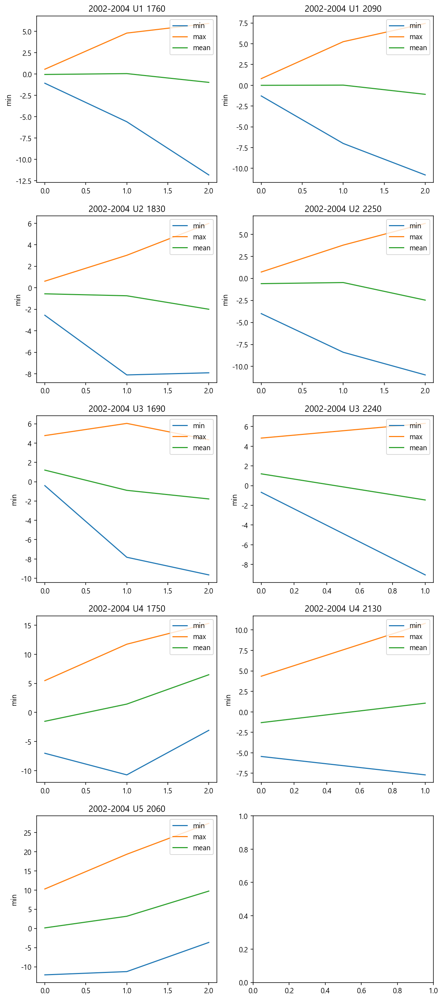

In [158]:
fig, ax = plt.subplots(ncols = 2, nrows = 5, figsize = (10, 25))

#u1
u1 = sns.lineplot(x = u1_1760_describe.index, y = u1_1760_describe['min'], ax = ax[0,0])
u1 = sns.lineplot(x = u1_1760_describe.index, y = u1_1760_describe['max'], ax = ax[0,0])
u1 = sns.lineplot(x = u1_1760_describe.index, y = u1_1760_describe['mean'], ax = ax[0,0])
u1.set_title("2002-2004 U1 1760")
u1.legend(labels = u1_1760_describe.columns, loc = 'upper right')

u11 = sns.lineplot(x = u1_2090_describe.index, y = u1_2090_describe['min'], ax = ax[0,1])
u11 = sns.lineplot(x = u1_2090_describe.index, y = u1_2090_describe['max'], ax = ax[0,1])
u11 = sns.lineplot(x = u1_2090_describe.index, y = u1_2090_describe['mean'], ax = ax[0,1])
u11.set_title("2002-2004 U1 2090")
u11.legend(labels = u1_2090_describe.columns, loc = 'upper right')

#u2
u2 = sns.lineplot(x = u2_1830_describe.index, y = u2_1830_describe['min'], ax = ax[1,0])
u2 = sns.lineplot(x = u2_1830_describe.index, y = u2_1830_describe['max'], ax = ax[1,0])
u2 = sns.lineplot(x = u2_1830_describe.index, y = u2_1830_describe['mean'], ax = ax[1,0])
u2.set_title("2002-2004 U2 1830")
u2.legend(labels = u2_1830_describe.columns, loc = 'upper right')

u22 = sns.lineplot(x = u2_2250_describe.index, y = u2_2250_describe['min'], ax = ax[1,1])
u22 = sns.lineplot(x = u2_2250_describe.index, y = u2_2250_describe['max'], ax = ax[1,1])
u22 = sns.lineplot(x = u2_2250_describe.index, y = u2_2250_describe['mean'], ax = ax[1,1])
u22.set_title("2002-2004 U2 2250")
u22.legend(labels = u2_2250_describe.columns, loc = 'upper right')

#u3
u3 = sns.lineplot(x = u3_1690_describe.index, y = u3_1690_describe['min'], ax = ax[2,0])
u3 = sns.lineplot(x = u3_1690_describe.index, y = u3_1690_describe['max'], ax = ax[2,0])
u3 = sns.lineplot(x = u3_1690_describe.index, y = u3_1690_describe['mean'], ax = ax[2,0])
u3.set_title("2002-2004 U3 1690")
u3.legend(labels = u3_1690_describe.columns, loc = 'upper right')

u33 = sns.lineplot(x = u3_2240_describe.index, y = u3_2240_describe['min'], ax = ax[2,1])
u33 = sns.lineplot(x = u3_2240_describe.index, y = u3_2240_describe['max'], ax = ax[2,1])
u33 = sns.lineplot(x = u3_2240_describe.index, y = u3_2240_describe['mean'], ax = ax[2,1])
u33.set_title("2002-2004 U3 2240")
u33.legend(labels = u3_2240_describe.columns, loc = 'upper right')

#u4
u4 = sns.lineplot(x = u4_1750_describe.index, y = u4_1750_describe['min'], ax = ax[3,0])
u4 = sns.lineplot(x = u4_1750_describe.index, y = u4_1750_describe['max'], ax = ax[3,0])
u4 = sns.lineplot(x = u4_1750_describe.index, y = u4_1750_describe['mean'], ax = ax[3,0])
u4.set_title("2002-2004 U4 1750")
u4.legend(labels = u4_1750_describe.columns, loc = 'upper right')

u44 = sns.lineplot(x = u4_2130_describe.index, y = u4_2130_describe['min'], ax = ax[3,1])
u44 = sns.lineplot(x = u4_2130_describe.index, y = u4_2130_describe['max'], ax = ax[3,1])
u44 = sns.lineplot(x = u4_2130_describe.index, y = u4_2130_describe['mean'], ax = ax[3,1])
u44.set_title("2002-2004 U4 2130")
u44.legend(labels = u4_2130_describe.columns, loc = 'upper right')

#u5
u5 = sns.lineplot(x = u5_2060_describe.index, y = u5_2060_describe['min'], ax = ax[4,0])
u5 = sns.lineplot(x = u5_2060_describe.index, y = u5_2060_describe['max'], ax = ax[4,0])
u5 = sns.lineplot(x = u5_2060_describe.index, y = u5_2060_describe['mean'], ax = ax[4,0])
u5.set_title("2002-2004 U5 2060")
u5.legend(labels = u5_2060_describe.columns, loc = 'upper right')

* Western UIG 부분은 평균 유속이 느려지고 있음을 확인 (북 -> 남)
* Eastern UIG 부분은 평균 유속이 빨라지고 있음을 확인 (남 -> 북)

## 상관관계 Heatmap

In [159]:
df_u1_u5 = pd.DataFrame()

for i in list(U1_5.keys())[2:]:
    df_u1_u5 = df_u1_u5.append(U1_5[i])

df_u1_u5

,Year,Month,Day,Hour,Minute,Second,Depth (meter),Ur Current speed (cm/s)
0,2002,11,30,11,0,0,1760,0.000002
1,2002,11,30,12,0,0,1760,0.000015
2,2002,11,30,13,0,0,1760,0.000069
3,2002,11,30,14,0,0,1760,0.000218
4,2002,11,30,15,0,0,1760,0.000531
...,...,...,...,...,...,...,...,...
11894,2004,4,7,4,0,0,2060,13.189926
11895,2004,4,7,5,0,0,2060,13.200081
11896,2004,4,7,6,0,0,2060,13.216570
11897,2004,4,7,7,0,0,2060,13.240629


<Figure size 720x720 with 0 Axes>

<AxesSubplot:>

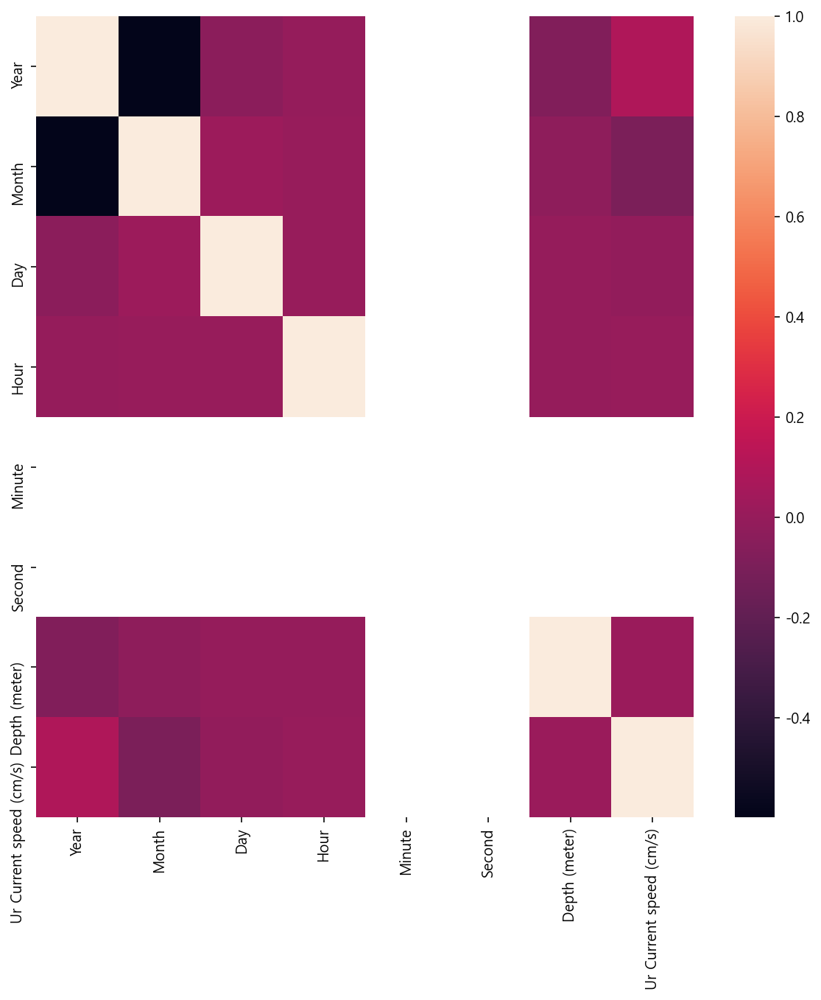

In [160]:
plt.figure(figsize = (10, 10))

sns.heatmap(df_u1_u5.corr())

## 습도, 기온, 수온 추세 확인

In [161]:
fig = px.line(data_ex, x = data_ex['일시'], y = data_ex['습도(%)'])
fig.show()

In [162]:
fig = px.line(data_ex, x = data_ex['일시'], y = data_ex['기온(°C)'])
fig.show()

In [163]:
fig = px.line(data_ex, x = data_ex['일시'], y = data_ex['수온(°C)'])
fig.show()